In [1]:
import plotly.express as px
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

In [2]:
ts = pd.read_csv('datasets/daily_supply.csv')
ts['date'] = pd.to_datetime(ts['date'])
ts.head()

,date,gas,hydro,renewables,imports,total
0,2018-04-12 00:00:00,5853.0,3510.0,5853.0,5263.0,20479.0
1,2018-04-12 00:05:00,6011.0,3414.0,5824.0,5117.0,20366.0
2,2018-04-12 00:10:00,6286.0,3104.0,5860.0,5281.0,20531.0
3,2018-04-12 00:15:00,6317.0,3056.0,5915.0,5296.0,20584.0
4,2018-04-12 00:20:00,6019.0,3124.0,5943.0,5439.0,20525.0


In [3]:
ts.set_index('date', inplace=True)

### Months

In [4]:
ms = ts.resample('M').mean()
ms.head()

,gas,hydro,renewables,imports,total
date,,,,,
2018-04-30,4725.362337,2802.972018,7901.929534,5490.097018,20920.360907
2018-05-31,4022.942198,2523.375378,8961.987342,6468.208357,21976.513274
2018-06-30,5814.850116,2564.413657,9197.809722,6998.532870,24575.606366
2018-07-31,12040.124104,2704.631944,8189.706765,7446.067540,30380.530354
2018-08-31,11067.398409,2500.972670,8367.476703,7698.859879,29634.707661


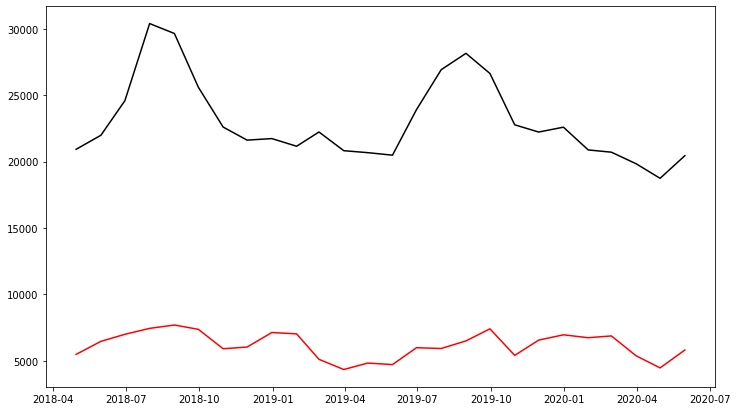

In [5]:
plt.figure(figsize=(12,7))
plt.plot(ms['imports'],'r-')
plt.plot(ms['total'],'k-')

### Days

In [6]:
ds = ts.resample('D').mean()
ds.head()

,gas,hydro,renewables,imports,total
date,,,,,
2018-04-12,4940.746528,3085.361111,8458.534722,5661.927083,22146.569444
2018-04-13,5744.770833,2855.659722,7253.472222,6133.538194,21987.440972
2018-04-14,5292.142361,2739.593750,7041.854167,5319.628472,20393.218750
2018-04-15,4190.218750,3027.121528,6883.954861,4355.718750,18457.013889
2018-04-16,4241.222222,3187.121528,7425.024306,6107.680556,20961.048611


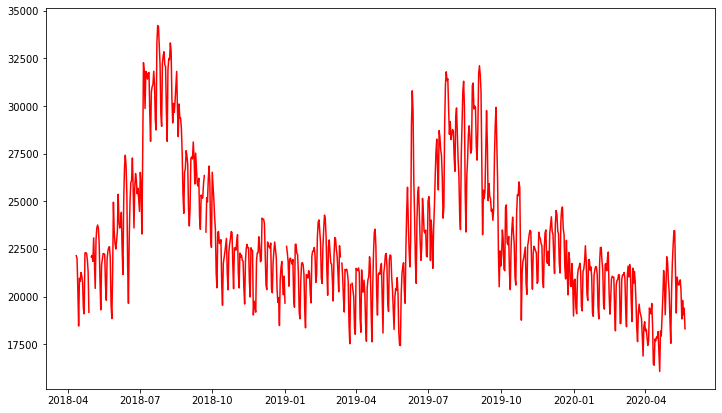

In [7]:
plt.figure(figsize=(12,7))
plt.plot(ds['total'],'r-')

In [8]:
hs = ts.resample('H').mean()
hs.head()

,gas,hydro,renewables,imports,total
date,,,,,
2018-04-12 00:00:00,5928.750000,3046.000000,5940.333333,5525.083333,20440.166667
2018-04-12 01:00:00,5429.750000,2690.333333,5762.000000,5913.666667,19795.750000
2018-04-12 02:00:00,5029.250000,2702.250000,5772.750000,5854.500000,19358.750000
2018-04-12 03:00:00,4991.583333,2653.500000,5622.750000,5902.500000,19170.333333
2018-04-12 04:00:00,4863.250000,2970.416667,5192.416667,6180.416667,19206.500000


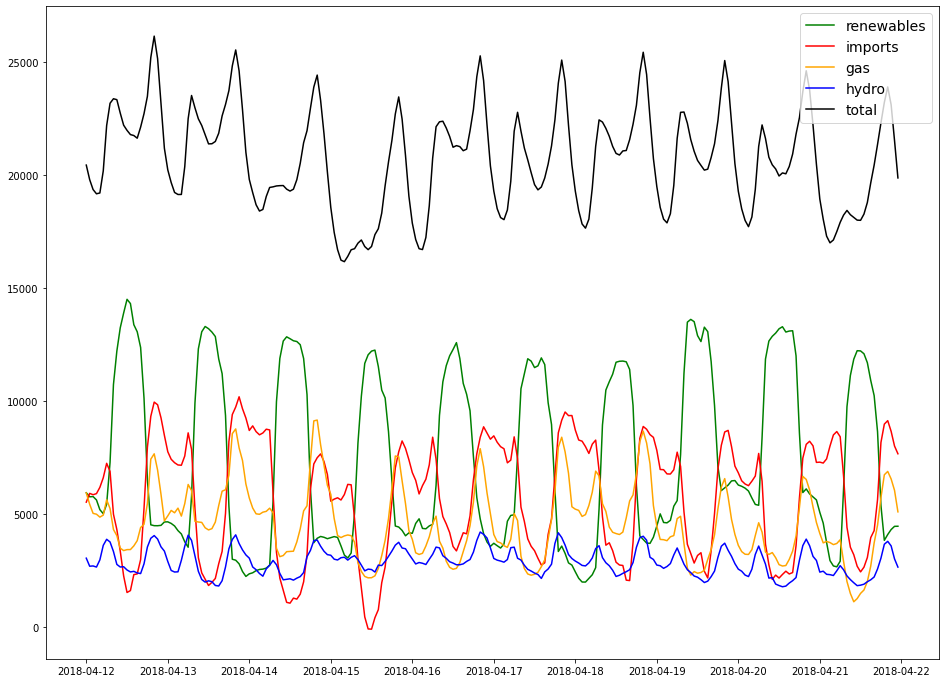

In [9]:
plt.figure(figsize=(16,12))
plt.plot(hs['renewables'][0:240],'g-',label='renewables')
plt.plot(hs['imports'][0:240],'r-',label='imports')
plt.plot(hs['gas'][0:240],'orange',label='gas')
plt.plot(hs['hydro'][0:240],'b-',label='hydro')
plt.plot(hs['total'][0:240],'k-',label='total')
plt.legend(fontsize=14)

In [37]:
ts['total'].head()

date
2018-04-12 00:00:00    20479.0
2018-04-12 00:05:00    20366.0
2018-04-12 00:10:00    20531.0
2018-04-12 00:15:00    20584.0
2018-04-12 00:20:00    20525.0
Name: total, dtype: float64

In [34]:
type(hs.index[0])

pandas._libs.tslibs.timestamps.Timestamp

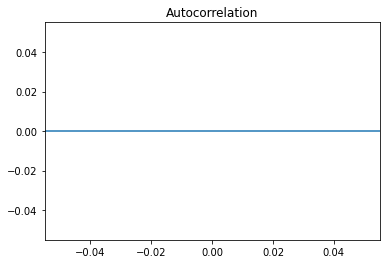

In [36]:
plot_acf(ts['total'],lags=30);

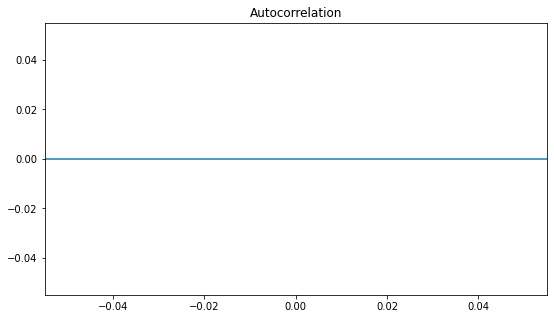

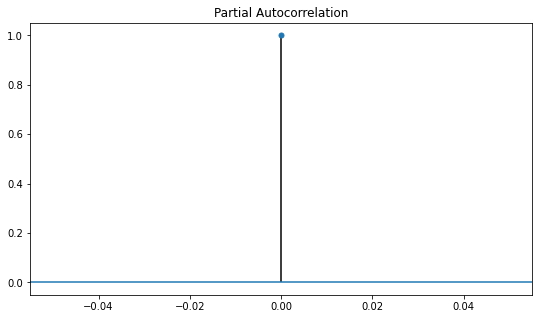

In [30]:
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
%matplotlib inline

fig, ax = plt.subplots(figsize = (9, 5))
plot_acf(hs['total'], lags = 30, ax = ax)
plt.show();

fig, ax = plt.subplots(figsize = (9, 5))
plot_pacf(hs['total'], lags = 30, ax = ax)
plt.show();